In [4]:
!pip install vaderSentiment

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import time
import re
import warnings
warnings.filterwarnings('ignore')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 1.2 MB/s eta 0:00:00


In [5]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
analyzer = SentimentIntensityAnalyzer()

In [6]:
df = pd.read_excel('/content/preprocessed_datas.xlsx')

In [7]:
df = df.drop(df[df['preprocessed_text'] == 'NaN'].index)
df.isna().sum().sort_values(ascending=False)

id                   0
url                  0
timestamp            0
text                 0
links                0
likes                0
replies              0
retweets             0
quotes               0
searchQuery          0
user                 0
preprocessed_text    0
dtype: int64

In [8]:
df = df.reset_index()

SENTIMENT SCORE GENERATOR

In [9]:
scores = []
compound_list = []
positive_list = []
negative_list = []
neutral_list = []
for i in range(df['preprocessed_text'].shape[0]):
    compound = analyzer.polarity_scores(df['preprocessed_text'][i])["compound"]
    pos = analyzer.polarity_scores(df['preprocessed_text'][i])["pos"]
    neu = analyzer.polarity_scores(df['preprocessed_text'][i])["neu"]
    neg = analyzer.polarity_scores(df['preprocessed_text'][i])["neg"]

    scores.append({"Compound": compound,
                       "Positive": pos,
                       "Negative": neg,
                       "Neutral": neu
                  })

sentiments_score = pd.DataFrame.from_dict(scores)
df = df.join(sentiments_score)
df.head()


,index,id,url,timestamp,text,links,likes,replies,retweets,quotes,searchQuery,user,preprocessed_text,Compound,Positive,Negative,Neutral
0,0,682120065274134528,https://twitter.com/AlokKumarBihari/status/682...,2015-12-30 14:14:00,@PTI_News sir My new innovative idea to save ...,[List],0,0,0,0,GlobalWarming,[Record],ptinew sir new innov idea save earth global wa...,0.4295,0.263,0.117,0.620
1,1,682292581175177216,https://twitter.com/shzlnyusof/status/68229258...,2015-12-31 01:40:00,Pehal? Environment? Same la ng aku pakai produ...,[List],0,0,0,0,Environment,[Record],pehal environ la ng aku pakai produk tah pape ...,0.0000,0.000,0.000,1.000
2,2,682218781909905408,https://twitter.com/ChubbyShiro/status/6822187...,2015-12-30 20:46:00,I'm at ดิงก้าพาราไดซ์(Dinga's Paradise) in Glo...,[List],0,0,0,0,GlobalWarming,[Record],im ดิงก้าพาราไดซ์dinga paradis global warm swa...,0.2263,0.275,0.000,0.725
3,3,682275394297270272,https://twitter.com/Allyasmsdn/status/68227539...,2015-12-31 00:31:00,"Road map, better coordination, focus on forwar...",[List],1,0,0,0,Environment,[Record],road map better coordin focu forward think par...,0.4404,0.195,0.000,0.805
4,4,682238584141684736,https://twitter.com/skkhemkaji/status/68223858...,2015-12-30 22:05:00,More and more use of solar power and planting ...,[List],0,0,0,0,Environment,[Record],use solar power plant tree urban area r best s...,0.6369,0.244,0.000,0.756


CLASSIFYING TWEETS AS POSITIVE, NEGATIVE OR NEUTRAL

In [10]:
conditions = [
    (df['Compound'] <= -0.5),
    (df['Compound'] > -0.5) & (df['Compound'] < 0.5),
    (df['Compound'] > 0.5)
    ]

values = ['Negative', 'Neutral', 'Positive']

df['Category'] = np.select(conditions, values)
df.head()


,index,id,url,timestamp,text,links,likes,replies,retweets,quotes,searchQuery,user,preprocessed_text,Compound,Positive,Negative,Neutral,Category
0,0,682120065274134528,https://twitter.com/AlokKumarBihari/status/682...,2015-12-30 14:14:00,@PTI_News sir My new innovative idea to save ...,[List],0,0,0,0,GlobalWarming,[Record],ptinew sir new innov idea save earth global wa...,0.4295,0.263,0.117,0.620,Neutral
1,1,682292581175177216,https://twitter.com/shzlnyusof/status/68229258...,2015-12-31 01:40:00,Pehal? Environment? Same la ng aku pakai produ...,[List],0,0,0,0,Environment,[Record],pehal environ la ng aku pakai produk tah pape ...,0.0000,0.000,0.000,1.000,Neutral
2,2,682218781909905408,https://twitter.com/ChubbyShiro/status/6822187...,2015-12-30 20:46:00,I'm at ดิงก้าพาราไดซ์(Dinga's Paradise) in Glo...,[List],0,0,0,0,GlobalWarming,[Record],im ดิงก้าพาราไดซ์dinga paradis global warm swa...,0.2263,0.275,0.000,0.725,Neutral
3,3,682275394297270272,https://twitter.com/Allyasmsdn/status/68227539...,2015-12-31 00:31:00,"Road map, better coordination, focus on forwar...",[List],1,0,0,0,Environment,[Record],road map better coordin focu forward think par...,0.4404,0.195,0.000,0.805,Neutral
4,4,682238584141684736,https://twitter.com/skkhemkaji/status/68223858...,2015-12-30 22:05:00,More and more use of solar power and planting ...,[List],0,0,0,0,Environment,[Record],use solar power plant tree urban area r best s...,0.6369,0.244,0.000,0.756,Positive


In [11]:
df.to_excel('classify.xlsx')

In [13]:
pd.DataFrame(df.groupby(['Category'])['Category'].count()).rename(columns={"Category":"Counts"}).assign(
    Percentage=lambda x: (x.Counts/ x.Counts.sum())*100)

,Counts,Percentage
Category,,
Negative,1792,6.364540
Neutral,20615,73.217076
Positive,5749,20.418383


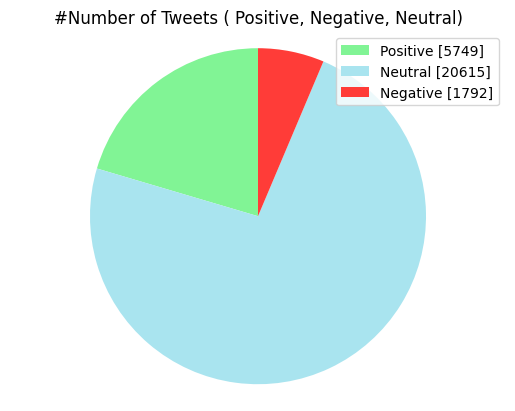

In [14]:
positive=5749
neutral=20615
negative=1792

#Creating PieChart
labels = ['Positive ['+str(positive)+']' , 'Neutral ['+str(neutral)+']','Negative ['+str(negative)+']']
sizes = [positive, neutral, negative]
colors = ["#81F495","#A9E4EF","#FF3C38"]
patches, texts = plt.pie(sizes,colors=colors, startangle=90)
plt.style.use('default')
plt.legend(labels)
plt.title( '#Number of Tweets ( Positive, Negative, Neutral)' )
plt.axis('equal')
plt.show()

yearwise anlysis of tweets

In [15]:
df['Timestamp'] = pd.to_datetime(df['timestamp'])
df['Year'] = df['Timestamp'].dt.year

df_result = (df.groupby(['Year', 'Category'])['Category']
             .count()
             .unstack(fill_value=0)
             .rename(columns={"positive": "Positive", "negative": "Negative", "neutral": "Neutral"})
             .assign(Total=lambda x: x.sum(axis=1))
             .assign(Positive_Percentage=lambda x: (x['Positive'] / x['Total']) * 100)
             .assign(Negative_Percentage=lambda x: (x['Negative'] / x['Total']) * 100)
             .assign(Neutral_Percentage=lambda x: (x['Neutral'] / x['Total']) * 100)
             .reset_index()
             )

print(df_result)

Category  Year  Negative  Neutral  Positive  Total  Positive_Percentage  \
0         2015       395     5045       967   6407            15.092867   
1         2016       301     5577      1173   7051            16.635938   
2         2017       428     3762      1088   5278            20.613869   
3         2018       272     2188       975   3435            28.384279   
4         2019       259     2535      1091   3885            28.082368   
5         2020       137     1508       455   2100            21.666667   

Category  Negative_Percentage  Neutral_Percentage  
0                    6.165132           78.742001  
1                    4.268898           79.095164  
2                    8.109132           71.276999  
3                    7.918486           63.697234  
4                    6.666667           65.250965  
5                    6.523810           71.809524  


Draw graph yearwise of postive negative and neutral

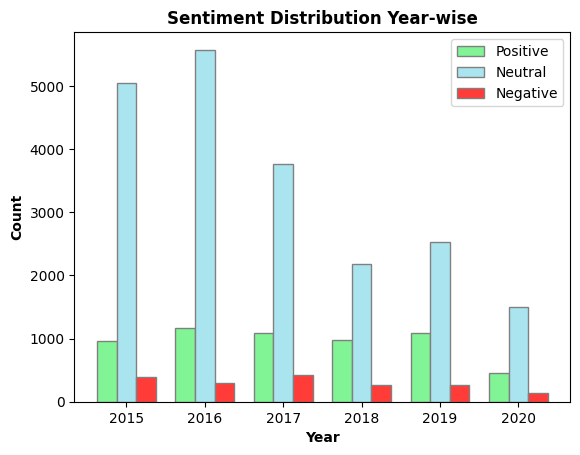

In [16]:
years = [2015, 2016, 2017, 2018, 2019, 2020]
positive_counts = [967, 1173, 1088, 975, 1091, 455]
neutral_counts = [5045, 5577, 3762, 2188, 2535, 1508]
negative_counts = [395, 301, 428, 272, 259, 137]

# Creating the histogram
barWidth = 0.25
r1 = range(len(years))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]

plt.bar(r1, positive_counts, color='#81F495', width=barWidth, edgecolor='grey', label='Positive')
plt.bar(r2, neutral_counts, color='#A9E4EF', width=barWidth, edgecolor='grey', label='Neutral')
plt.bar(r3, negative_counts, color='#FF3C38', width=barWidth, edgecolor='grey', label='Negative')

plt.xlabel('Year', fontweight='bold')
plt.xticks([r + barWidth for r in range(len(years))], years)
plt.ylabel('Count', fontweight='bold')
plt.title('Sentiment Distribution Year-wise', fontweight='bold')
plt.legend()

plt.show()

In [17]:
df['text_len'] = df['preprocessed_text'].astype(str).apply(len)
df['text_word_count'] = df['preprocessed_text'].apply(lambda x: len(str(x).split()))
print("Average length of tweets:", round(np.mean(df['text_len'])))
print("Average word counts of tweets:", round(np.mean(df['text_word_count'])))

Average length of tweets: 104
Average word counts of tweets: 14


Top 50 Positive Tweets

In [18]:
df.nlargest(n=50, columns=['Compound'])["preprocessed_text"]

25649    omg want full video best take climatechang eve...
26706    diya jalaan se global warm toh nahi hoga kya a...
17536    what temperatur btw got anoth reason global wa...
3401     iamsrk your respons global warm hot sir love u...
27465    wish u happi birthday first ladi america mr me...
27464    favor royal enfield hero cycl help reach desti...
21550    siddapuram preprimari school build health sub ...
12701    great compani great environ great food great g...
16523    parineetichopra good even pari💖 feel warm look...
24549    🌺🌺 ” clean environ clean bodi clean mind clean...
12170          half world white attack global warm ☺☺☺😊😊😊😊
1328     wherev soul environ 💕💕👌✌👍☺😀😍😘🙏👑 nagral kontik ...
20316    like celebr great work environment servic staf...
6919     evergreenlionheart excel chef cost effect tech...
17142    increas love caus higher global warm 😁😁😁😁😁😁👏👏👏...
19294    save tree save futur save tree save shelter an...
20942    realli feel amaz work ppp posit environmentim .

Top 50 negative tweets

In [19]:
df.nsmallest(n=50, columns=['Compound'])["preprocessed_text"]

15864    ameerul islam muslim migrant assam found guilt...
19058    😱😱😱😱😱 reason behind global warm harshitagaur12...
23042    recent news twitter make sad peopl leav world ...
26115    thing need repeat 2021 homeopathi scam astrolo...
23264    live 4 year kenya make livid charcoal kill peo...
14663    first end nuclear weapon second climat chang t...
26891    disturb 😢😢😢😢mi fav state 🔥 global warm fact le...
17628    yesterday bad dream see ruin one one shock tur...
19645    afg u drop 10000 bomb 💣 across afghanistan las...
22423    😭😭😭 tragedi human caus harm plant anim wildlif...
1492     lindseygrahamsc regard commend tell trump go h...
14428    liter kill heart feel pain beauti anim slowli ...
18185    petroleum black gold hellit produc greedlazine...
18577    choke death poison ga environ minist think fin...
25580    like serious one girl speak climat chang fool ...
27626    global serious lack front globalwarm terror ch...
3607     53 degre two day ago hell whatbth fuck global .

VISUALIZING SENTIMENT SCORES OF POSITIVE, NEUTRAL AND NEGATIVE TWEETS

<Axes: xlabel='Neutral', ylabel='Density'>

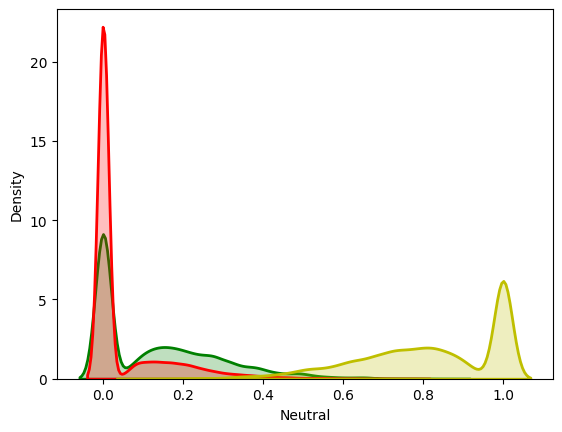

In [20]:
sns.distplot(df["Positive"], hist=False, kde=True,
             bins=int(180/5), color = 'green',
             hist_kws={'edgecolor':'black'},
             kde_kws={'shade': True,'linewidth': 2})

sns.distplot(df["Negative"], hist=False, kde=True,
             bins=int(180/5), color = 'red',
             hist_kws={'edgecolor':'black'},
             kde_kws={'shade': True,'linewidth': 2})

sns.distplot(df["Neutral"], hist=False, kde=True,
             bins=int(180/5), color = 'y',
             hist_kws={'edgecolor':'black'},
             kde_kws={'shade': True,'linewidth': 2})

visulization of sentiment score

<Axes: xlabel='Compound', ylabel='Density'>

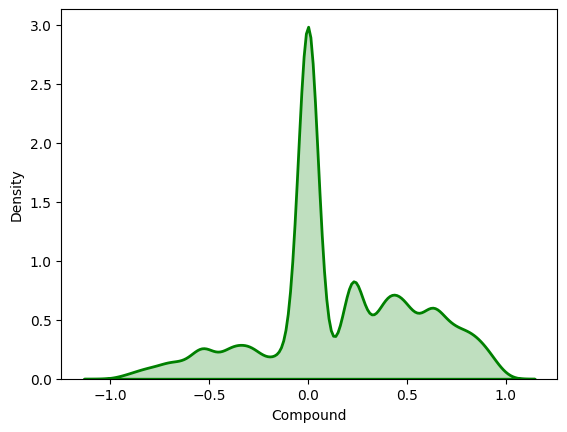

In [21]:
sns.distplot(df["Compound"], hist=False, kde=True,
             bins=int(180/5), color = 'green',
             hist_kws={'edgecolor':'black'},
             kde_kws={'shade': True,'linewidth': 2})


### **Word cloud**

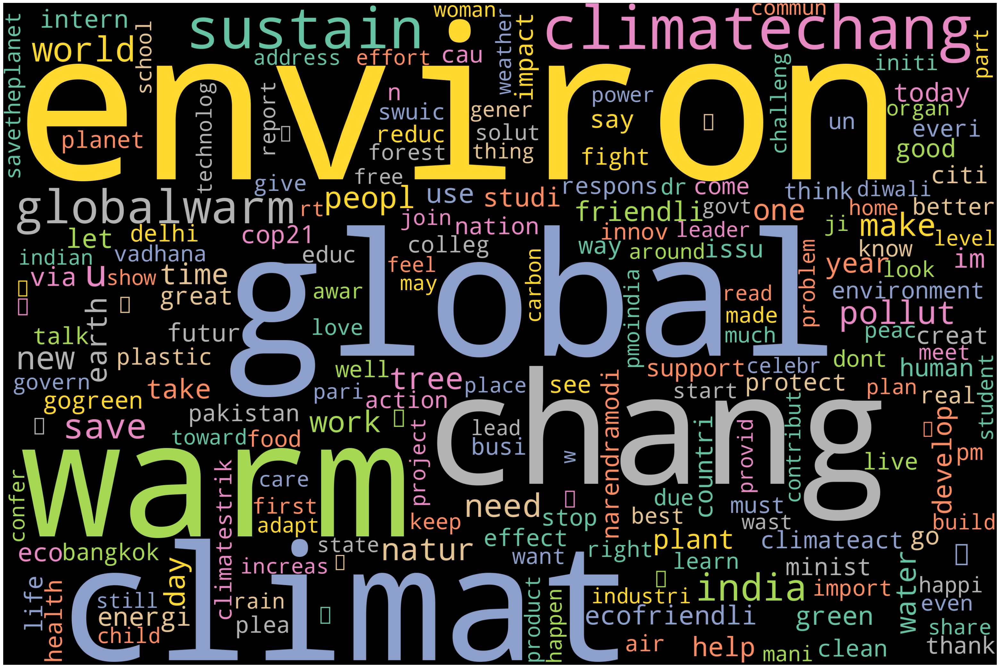

In [28]:
from wordcloud import WordCloud , STOPWORDS , ImageColorGenerator
from nltk import *


def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud)
    plt.axis("off");



text = " ".join(review for review in df.preprocessed_text)
wordcloud = WordCloud(width = 3000, height = 2000, stopwords=STOPWORDS, background_color="Black",colormap='Set2', collocations=False).generate(text)

plot_cloud(wordcloud)

save_wordcloud(wordcloud, "wordcloud.png")

making word cloud yearwise

Word Cloud for 2015


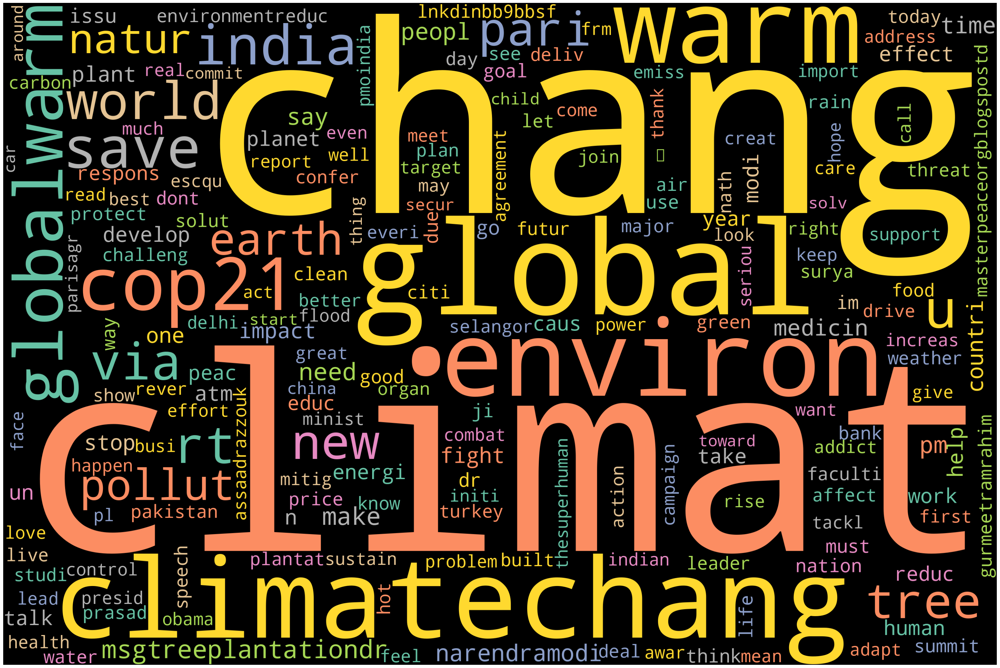

Word Cloud for 2016


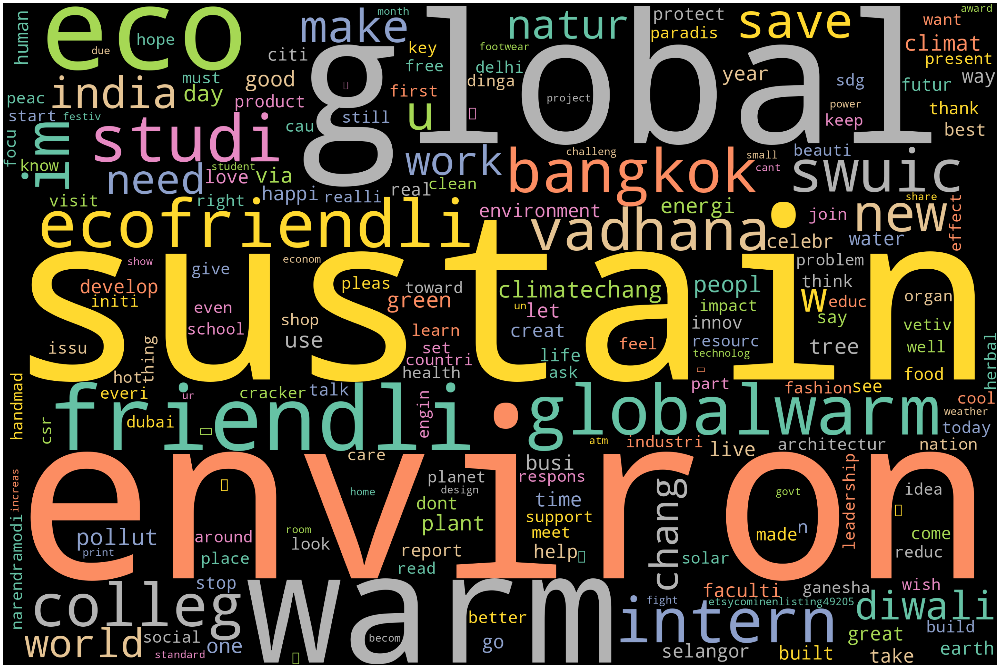

Word Cloud for 2017


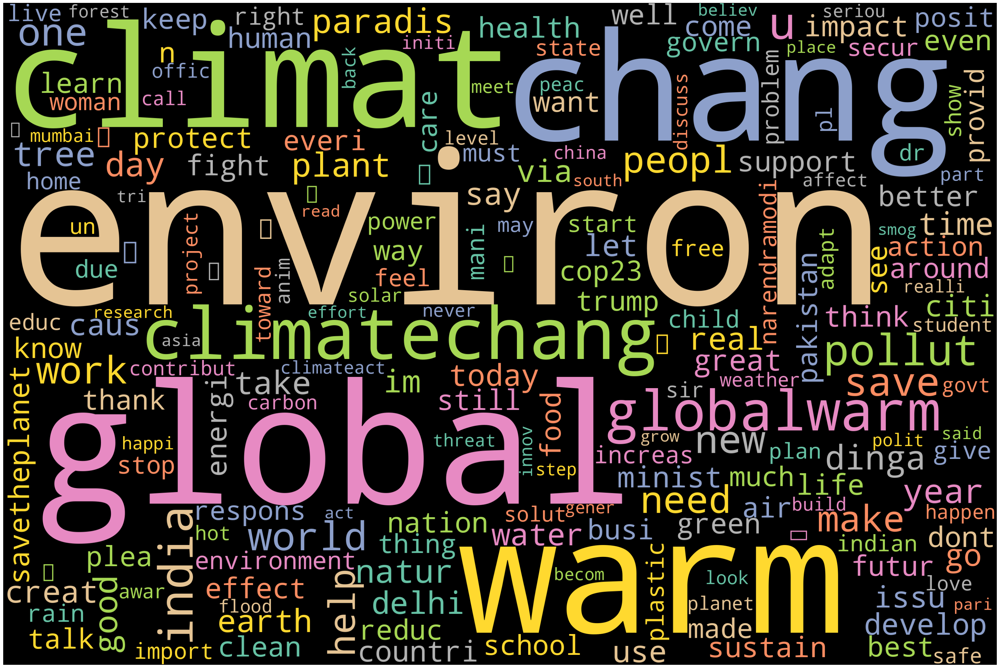

Word Cloud for 2018


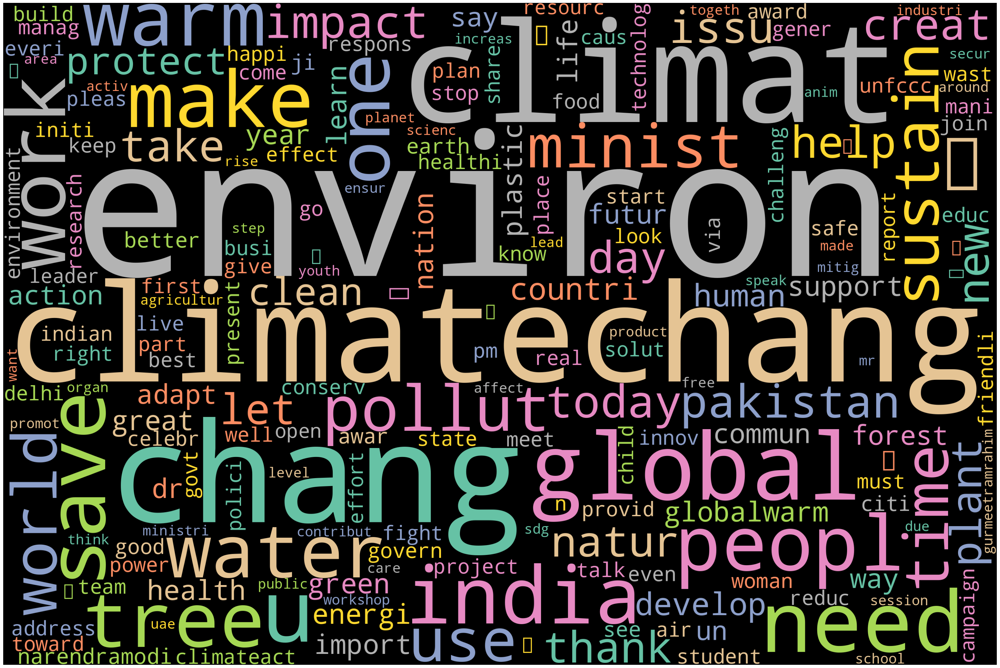

Word Cloud for 2019


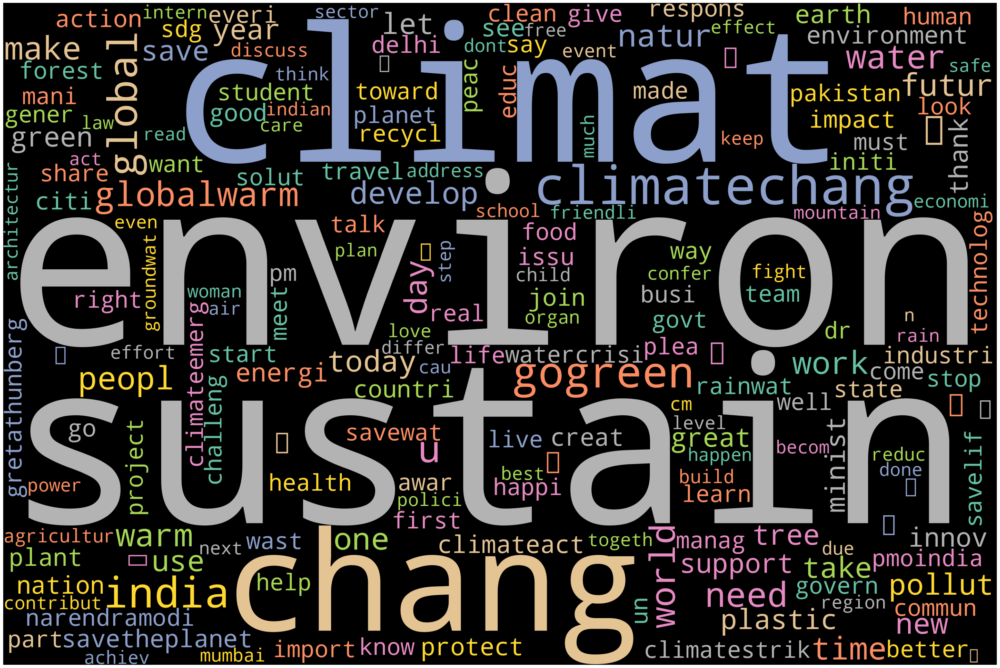

Word Cloud for 2020


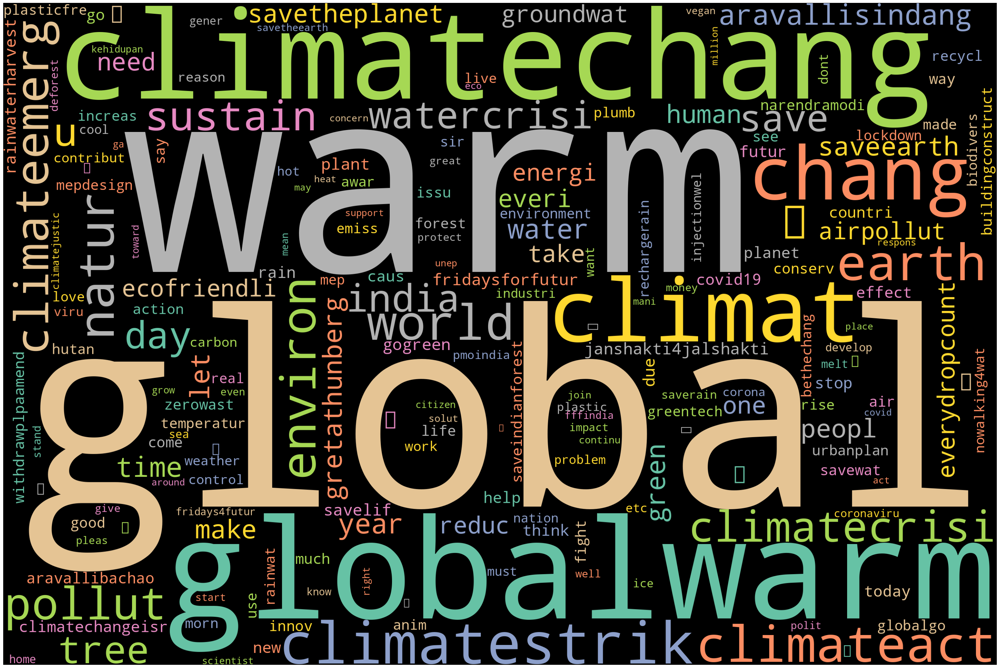

In [26]:
def save_wordcloud(wordcloud, filename):
    wordcloud.to_file(filename)

def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()

# Assuming your DataFrame is named 'df' and has columns 'Timestamp' and 'preprocessed_text'
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df['Year'] = df['Timestamp'].dt.year

# Create word clouds year-wise
years = df['Year'].unique()
for year in years:
    text_by_year = " ".join(df[df['Year'] == year]['preprocessed_text'])
    wordcloud = WordCloud(width=3000, height=2000, stopwords=STOPWORDS, background_color="black", colormap='Set2', collocations=False).generate(text_by_year)
    print(f"Word Cloud for {year}")
    plot_cloud(wordcloud)
    save_wordcloud(wordcloud, f"wordcloud_{year}.png")

**Negative**

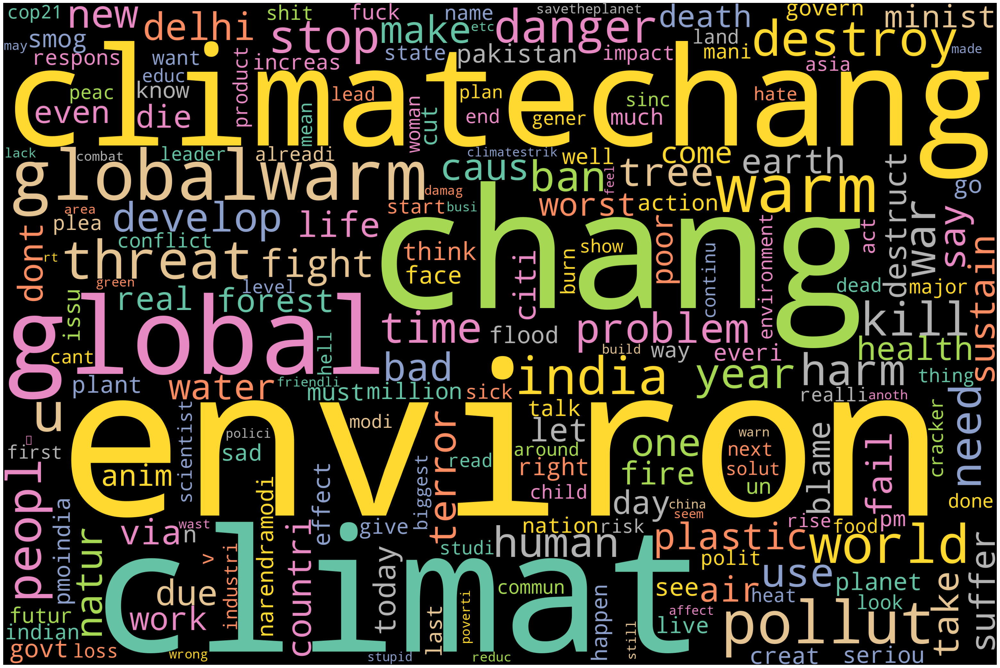

In [31]:
text = " ".join(review for review in df[df['Category']=='Negative'].preprocessed_text)
wordcloud = WordCloud(width = 3000, height = 2000, stopwords=STOPWORDS, background_color="Black",colormap='Set2', collocations=False).generate(text)
plot_cloud(wordcloud)


save_wordcloud(wordcloud, "Negative_wordcloud.png")

create negative wordcloud yearwise

Negative Word Cloud for 2015
Negative Word Cloud for 2016
Negative Word Cloud for 2017
Negative Word Cloud for 2018
Negative Word Cloud for 2019
Negative Word Cloud for 2020


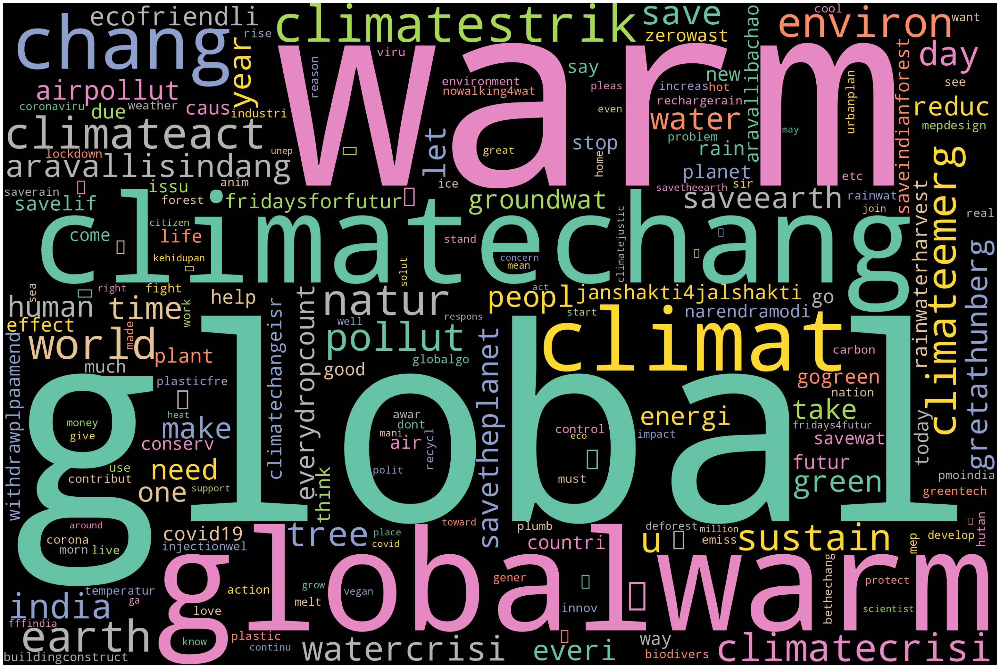

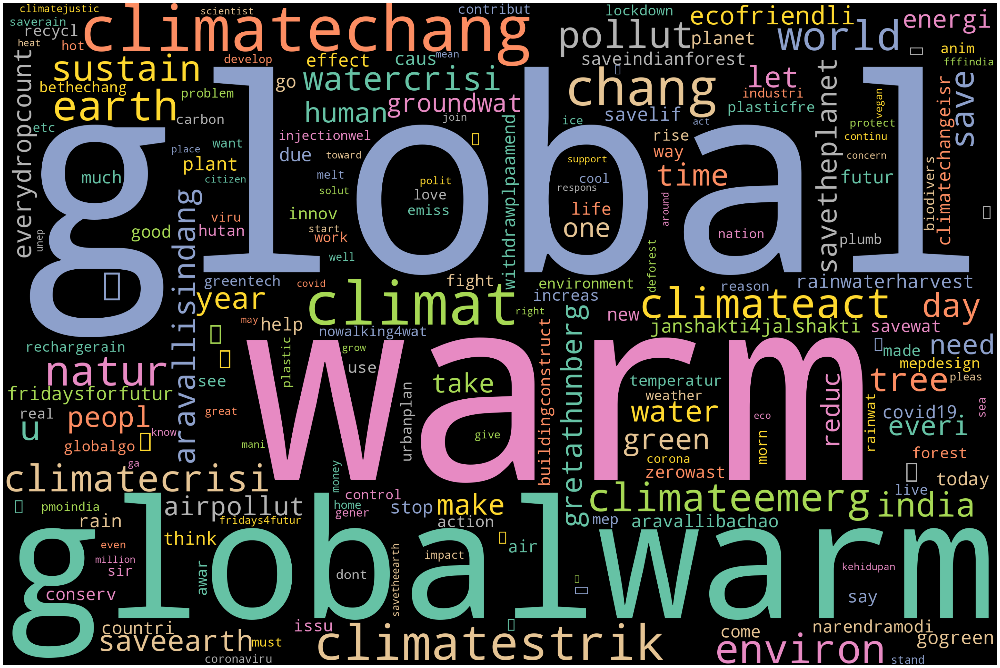

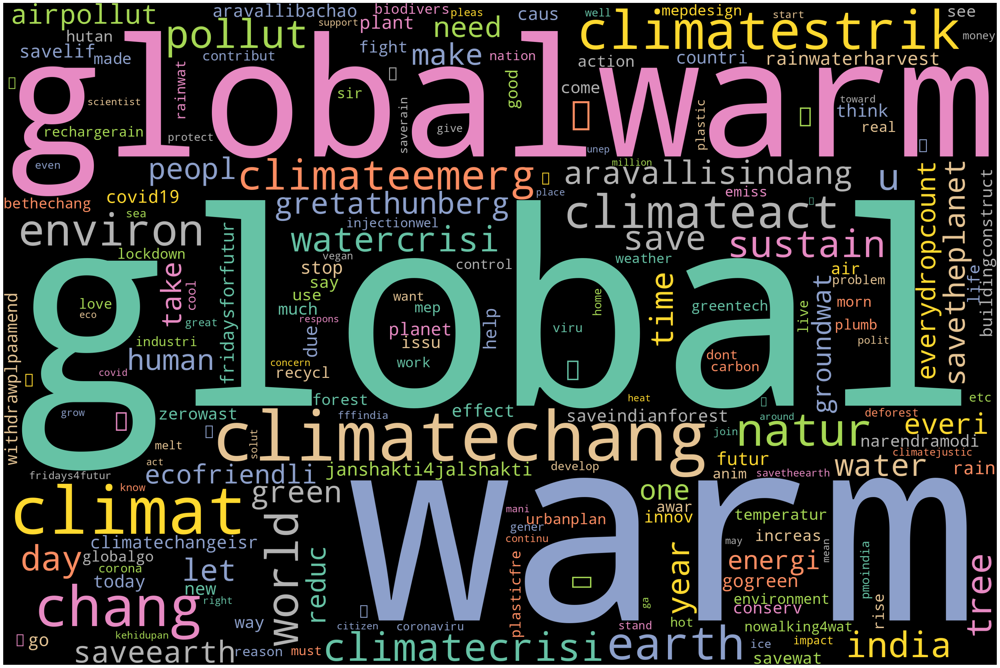

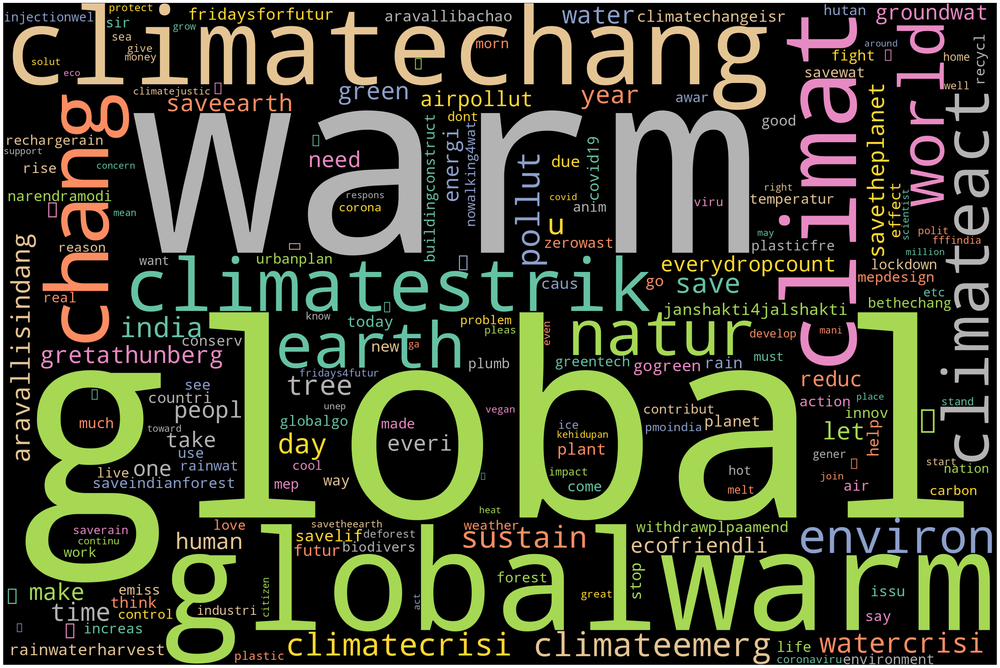

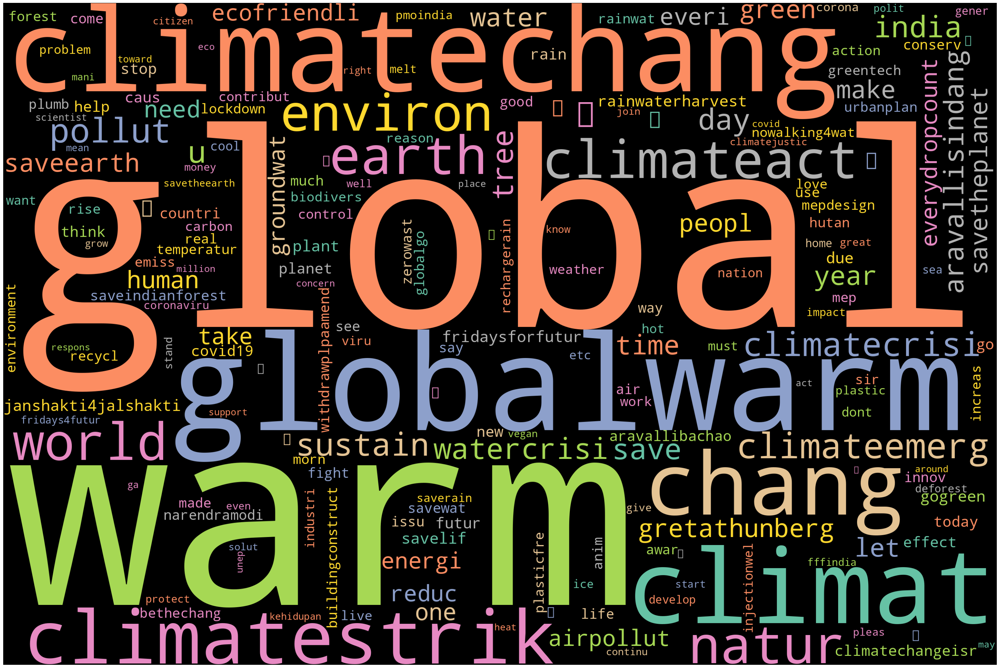

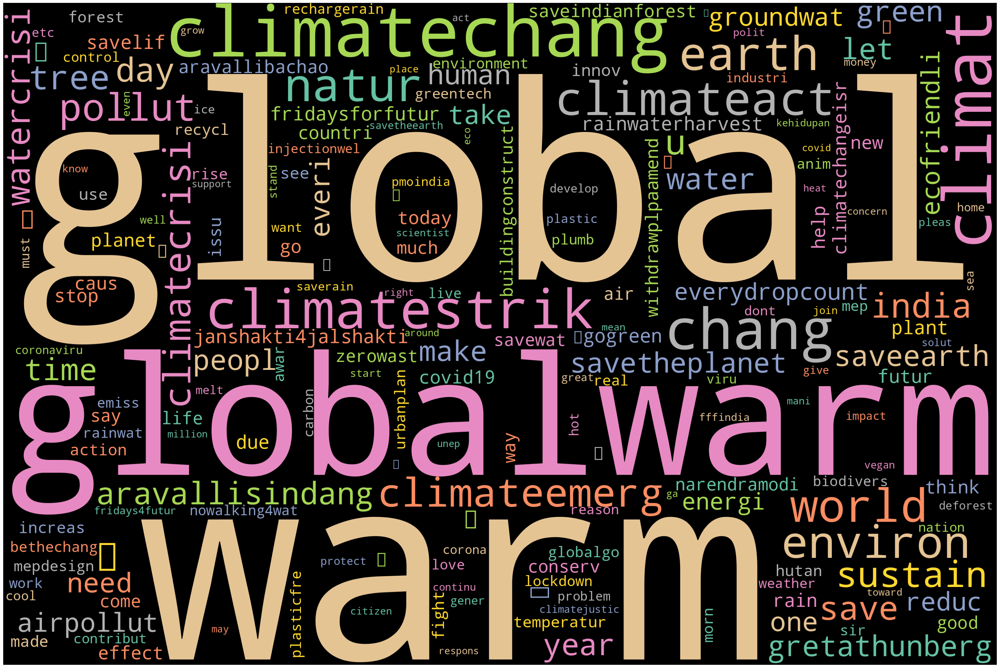

In [39]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df['Year'] = df['Timestamp'].dt.year

# Generate and save negative word clouds year-wise
unique_years = df['Year'].unique()

for year in unique_years:
    text = " ".join(df[(df['Category'] == 'Negative') & (df['Year'] == year)]['preprocessed_text'])
    wordcloud = WordCloud(width=3000, height=2000, stopwords=STOPWORDS, background_color="black", colormap='Set2', collocations=False).generate(text_by_year)
    print(f"Negative Word Cloud for {year}")
    plot_cloud(wordcloud)
    save_wordcloud(wordcloud, f"negative_wordcloud_{year}.png")


positive

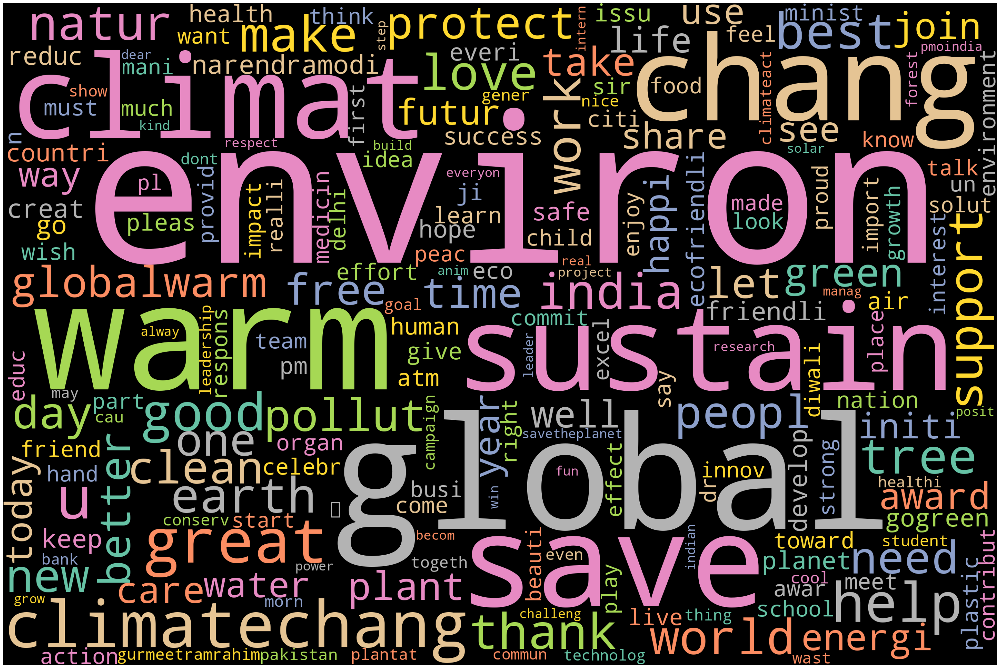

In [38]:

text = " ".join(review for review in df[df['Category']=='Positive'].preprocessed_text)
wordcloud = WordCloud(width = 3000, height = 2000, stopwords=STOPWORDS, background_color="Black",colormap='Set2', collocations=False).generate(text)
plot_cloud(wordcloud)
save_wordcloud(wordcloud, "Positive_wordcloud.png")


Create positive wordcloud yearwise

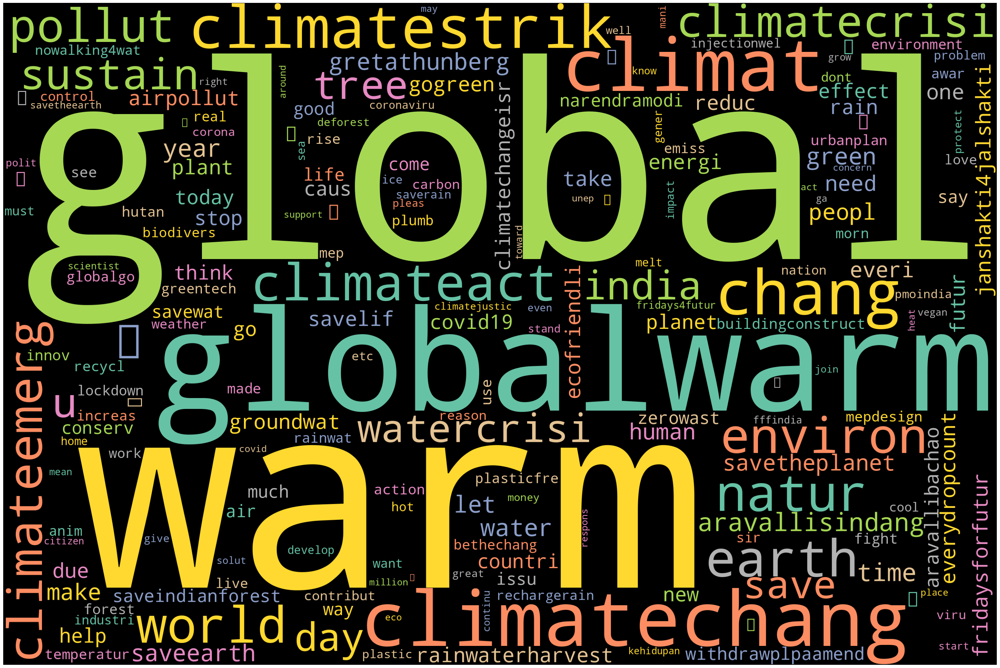

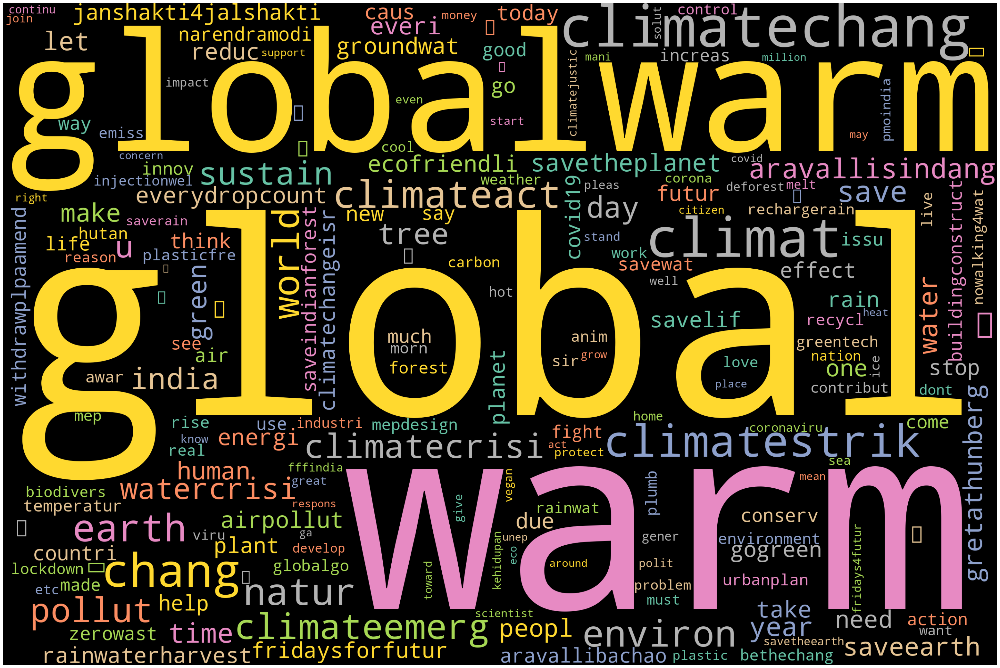

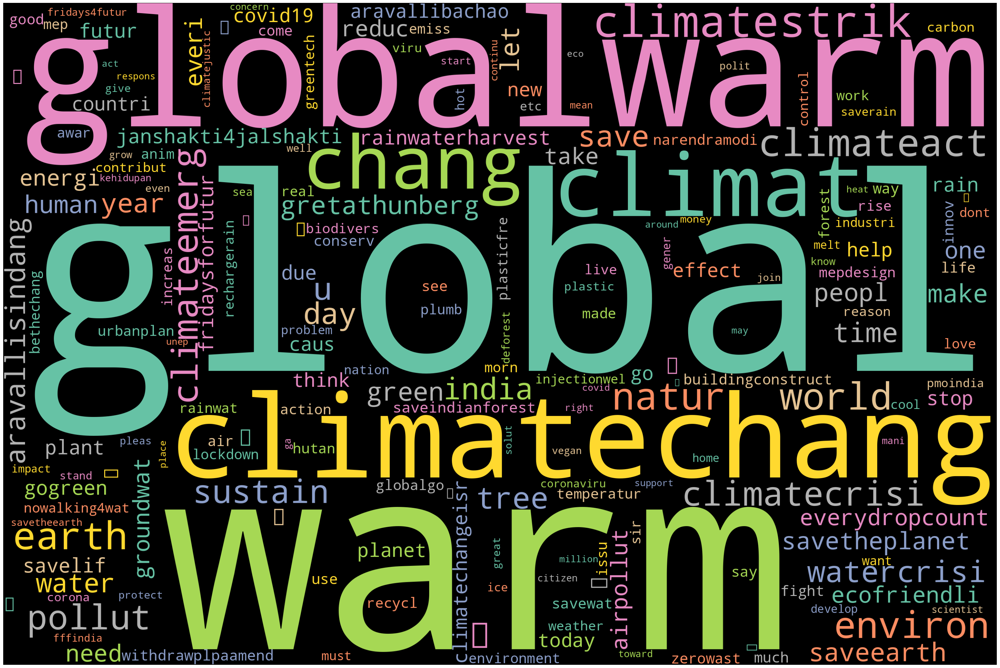

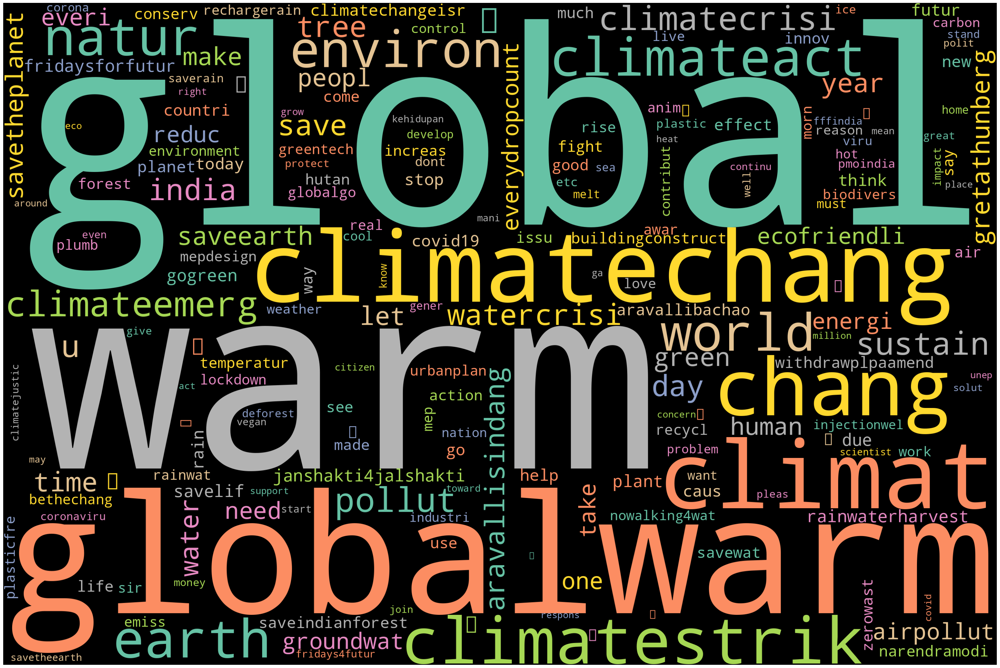

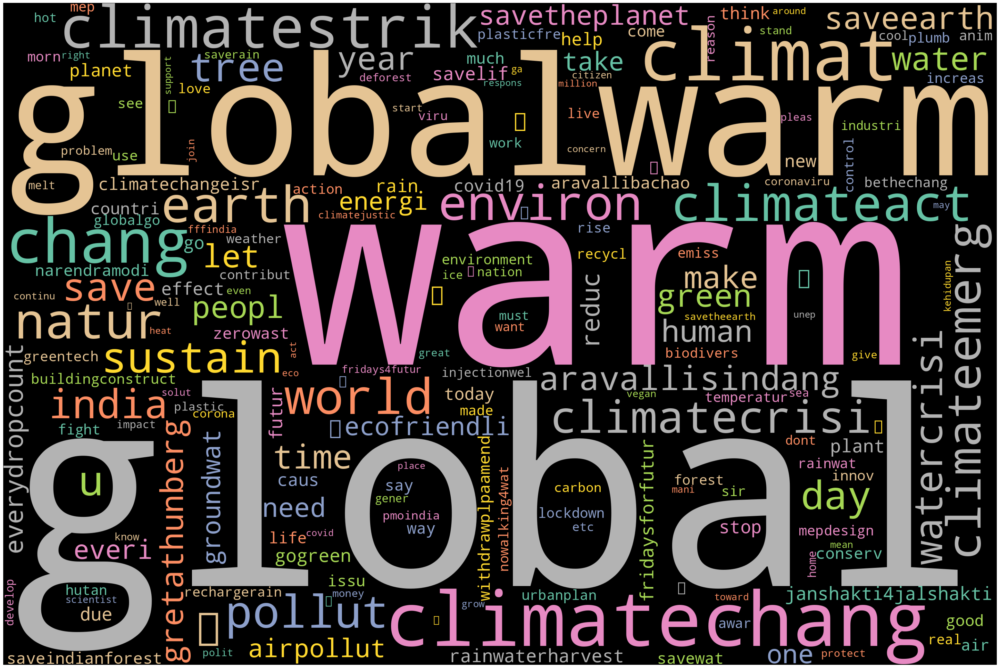

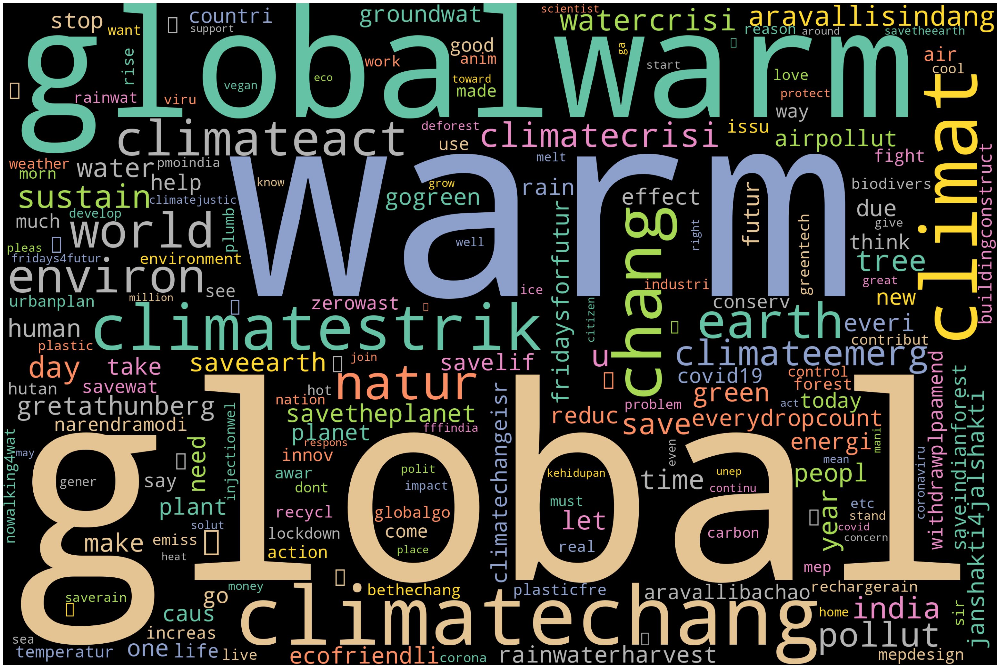

In [40]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df['Year'] = df['Timestamp'].dt.year

# Generate and save negative word clouds year-wise
unique_years = df['Year'].unique()

for year in unique_years:
    text = " ".join(df[(df['Category'] == 'Positive') & (df['Year'] == year)]['preprocessed_text'])
    wordcloud = WordCloud(width=3000, height=2000, stopwords=STOPWORDS, background_color="black", colormap='Set2', collocations=False).generate(text_by_year)

    plot_cloud(wordcloud)
    save_wordcloud(wordcloud, f"positive_wordcloud_{year}.png")
